# 1. Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import re
import string
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from wordcloud import WordCloud
from sklearn.preprocessing import LabelEncoder

from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer


#For Calculation of Performance of Models
from sklearn import metrics
from sklearn.metrics import f1_score,precision_score,recall_score,accuracy_score


#For Modelling Purpose
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression,SGDClassifier
from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier,AdaBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB,BernoulliNB,MultinomialNB
from sklearn.dummy import DummyClassifier
from sklearn.tree import ExtraTreeClassifier
from sklearn.multiclass import OneVsRestClassifier

import time
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

In [2]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\NTech\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [3]:
!pip install wordcloud

# 2. Loading the dataset

In [4]:
books_df = pd.read_csv("BooksDataset.csv")
books_df.head()

,Title,Authors,Description,Category,Publisher,Publish Date,Price
0,Goat Brothers,"By Colton, Larry",NaN,"History , General",Doubleday,"Friday, January 1, 1993",Price Starting at $8.79
1,The Missing Person,"By Grumbach, Doris",NaN,"Fiction , General",Putnam Pub Group,"Sunday, March 1, 1981",Price Starting at $4.99
2,Don't Eat Your Heart Out Cookbook,"By Piscatella, Joseph C.",NaN,"Cooking , Reference",Workman Pub Co,"Thursday, September 1, 1983",Price Starting at $4.99
3,When Your Corporate Umbrella Begins to Leak: A...,"By Davis, Paul D.",NaN,NaN,Natl Pr Books,"Monday, April 1, 1991",Price Starting at $4.99
4,Amy Spangler's Breastfeeding : A Parent's Guide,"By Spangler, Amy",NaN,NaN,Amy Spangler,"Saturday, February 1, 1997",Price Starting at $5.32


In [5]:
books_df.columns

Index(['Title', 'Authors', 'Description', 'Category', 'Publisher',
       'Publish Date', 'Price'],
      dtype='object')

# 3. Data Cleaning 

### i. Removing unnecessary Columns

In [6]:
books_df = books_df.drop(columns=['Price', 'Publish Date','Publisher','Authors'])

In [7]:
books_df.head()

,Title,Description,Category
0,Goat Brothers,NaN,"History , General"
1,The Missing Person,NaN,"Fiction , General"
2,Don't Eat Your Heart Out Cookbook,NaN,"Cooking , Reference"
3,When Your Corporate Umbrella Begins to Leak: A...,NaN,NaN
4,Amy Spangler's Breastfeeding : A Parent's Guide,NaN,NaN


### ii. Handling Missing Values

In [8]:
# Identifying missing values
print(books_df.isnull().sum())

Title              0
Description    32869
Category       26170
dtype: int64


In [9]:
books_df.shape

(103082, 3)

In [10]:
# Drop rows where either 'Description' or 'Category' is missing
df_cleaned = books_df.dropna(subset=['Description', 'Category'])
print(df_cleaned.shape)  # Check the number of remaining rows

(65305, 3)


In [11]:
# Identifying missing values
print(df_cleaned.isnull().sum())

Title          0
Description    0
Category       0
dtype: int64


In [12]:
# Save the cleaned DataFrame to a CSV file
df_cleaned.to_csv('cleaned_books_dataset03.csv', index=False)

In [13]:
df_cleaned.head()

,Title,Description,Category
7,Journey Through Heartsongs,Collects poems written by the eleven-year-old ...,"Poetry , General"
8,In Search of Melancholy Baby,The Russian author offers an affectionate chro...,"Biography & Autobiography , General"
10,The Dieter's Guide to Weight Loss During Sex,"A humor classic, this tongue-in-cheek diet pla...","Health & Fitness , Diet & Nutrition , Diets"
11,Germs : Biological Weapons and America's Secre...,"Deadly germs sprayed in shopping malls, bomb-l...","Technology & Engineering , Military Science"
13,The Good Book: Reading the Bible with Mind and...,"""The Bible and the social and moral consequenc...","Religion , Biblical Biography , General"


In [14]:
df_cleaned.nunique()

Title          62090
Description    64082
Category        2983
dtype: int64

### iii. Handling Duplicate Values

In [15]:
duplicate_titles = df_cleaned[df_cleaned['Title'].duplicated(keep=False)]
num_duplicates = df_cleaned['Title'].duplicated().sum()
print(f"Number of duplicate titles: {num_duplicates}")

Number of duplicate titles: 3215


In [16]:
df_cleaned = df_cleaned.drop_duplicates(subset=['Title'], keep='first')

In [17]:
df_cleaned.nunique()

Title          62090
Description    61340
Category        2972
dtype: int64

### iv. Text Preprocessing 

In [18]:
# Define stopwords
Stopwords = set(stopwords.words('english'))

# Initialize lemmatizer and stemmer
lemmatizer = WordNetLemmatizer()
stemmer = SnowballStemmer(language='english')

def clean_and_process(text):
    # Convert to lowercase
    text = text.lower()
    # Remove punctuation
    text = re.sub('[%s]' % re.escape(string.punctuation), ' ', text) 
    # Tokenization
    tokens = word_tokenize(text)  
    # Remove stopwords
    tokens = [word for word in tokens if word not in Stopwords] 
    # Lemmatization
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    # Stemming
    tokens = [stemmer.stem(word) for word in tokens]  
    # Reconstruct the text
    text = " ".join(tokens)  
    # Remove words with length <= 3
    tokens = [word for word in text.split() if len(word) > 3]
    text = " ".join(tokens)  
    # Remove single characters
    text = re.sub(r"\s+[a-zA-Z]\s+", ' ', text)  
    # Remove HTML tags
    text = re.sub('<.*?>+', ' ', text)  
    # Remove new line characters
    text = re.sub('\n', ' ', text) 
    # Remove multiple spaces
    text = re.sub(r'\s+', ' ', text)
    return text

In [19]:
df_cleaned['Description'] = df_cleaned['Description'].apply(clean_and_process)
df_cleaned['Title'] = df_cleaned['Title'].apply(clean_and_process)

In [20]:
df_cleaned

,Title,Description,Category
7,journey heartsong,collect poem written eleven year muscular dyst...,"Poetry , General"
8,search melancholi babi,russian author offer affection chronicl life u...,"Biography & Autobiography , General"
10,dieter guid weight loss,humor classic tongu cheek diet plan base calor...,"Health & Fitness , Diet & Nutrition , Diets"
11,germ biolog weapon america secret,dead germ spray shop mall bomb spew anthrax sp...,"Technology & Engineering , Military Science"
13,good book read bibl mind heart,bibl social moral consequ deriv interpret impo...,"Religion , Biblical Biography , General"
...,...,...,...
103069,like sister novel,sister exact first heard look mayb sometim nig...,"Fiction , Literary"
103071,creat page simplifi visual seri,owner manual first time page creator design bu...,"Computers , Internet , General"
103072,real creat wealth,call today hottest financi idea hotter fortun ...,"Business & Economics , Corporate Finance , Ge..."
103075,essenti spanish languag seri english spanish edit,essenti provid quick easi access critic inform...,"Foreign Language Study , Spanish"


In [21]:
# Keep only first category in category column
df_cleaned['Category'] = df_cleaned['Category'].apply(lambda x: x.split(',')[0].strip())

In [22]:
df_cleaned.head()

,Title,Description,Category
7,journey heartsong,collect poem written eleven year muscular dyst...,Poetry
8,search melancholi babi,russian author offer affection chronicl life u...,Biography & Autobiography
10,dieter guid weight loss,humor classic tongu cheek diet plan base calor...,Health & Fitness
11,germ biolog weapon america secret,dead germ spray shop mall bomb spew anthrax sp...,Technology & Engineering
13,good book read bibl mind heart,bibl social moral consequ deriv interpret impo...,Religion


# 4. EDA

In [23]:
df_cleaned['Category'].value_counts()

Category
Fiction                            16232
Juvenile Fiction                    6226
Religion                            3335
Cooking                             2829
Juvenile Nonfiction                 2606
Business & Economics                2450
History                             1954
Biography & Autobiography           1937
Political Science                   1732
Health & Fitness                    1525
Young Adult Fiction                 1458
Social Science                      1389
Family & Relationships              1213
Travel                              1141
Self-help                           1045
Sports & Recreation                 1027
Humor                                917
Reference                            838
Science                              834
Computers                            815
House & Home                         794
Psychology                           750
Crafts & Hobbies                     675
Pets                                 595
Gardeni

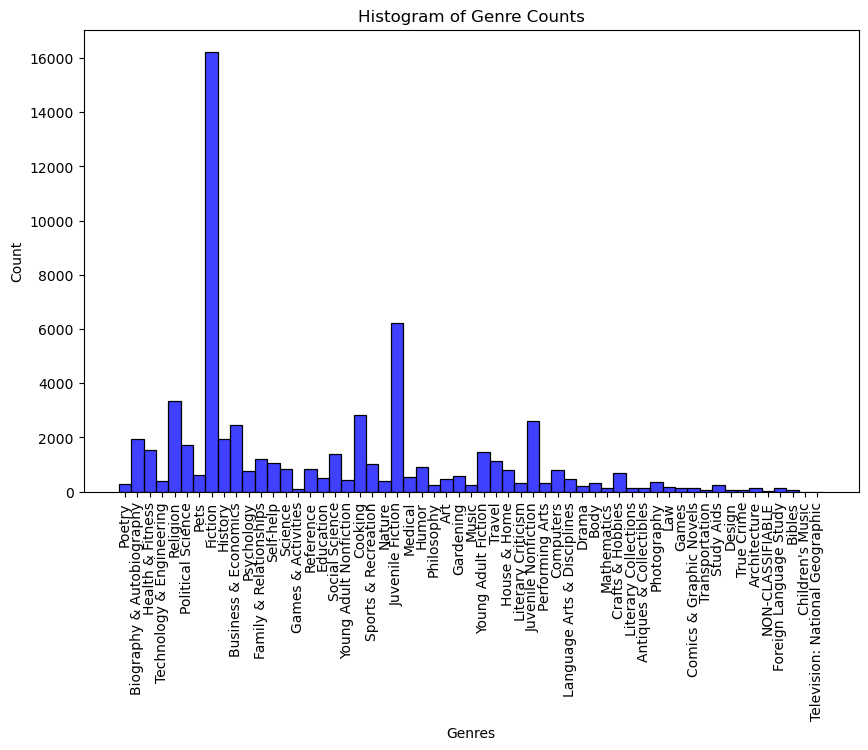

In [24]:
# Set the size of the plot
plt.figure(figsize=(10, 6))

# Create a histogram using seaborn
sns.histplot(df_cleaned['Category'], kde=False, bins=len(df_cleaned['Category'].unique()), color='blue')

# Customize the plot
plt.title('Histogram of Genre Counts')
plt.xlabel('Genres')
plt.ylabel('Count')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability

# Show the plot
plt.show()

### Histogram

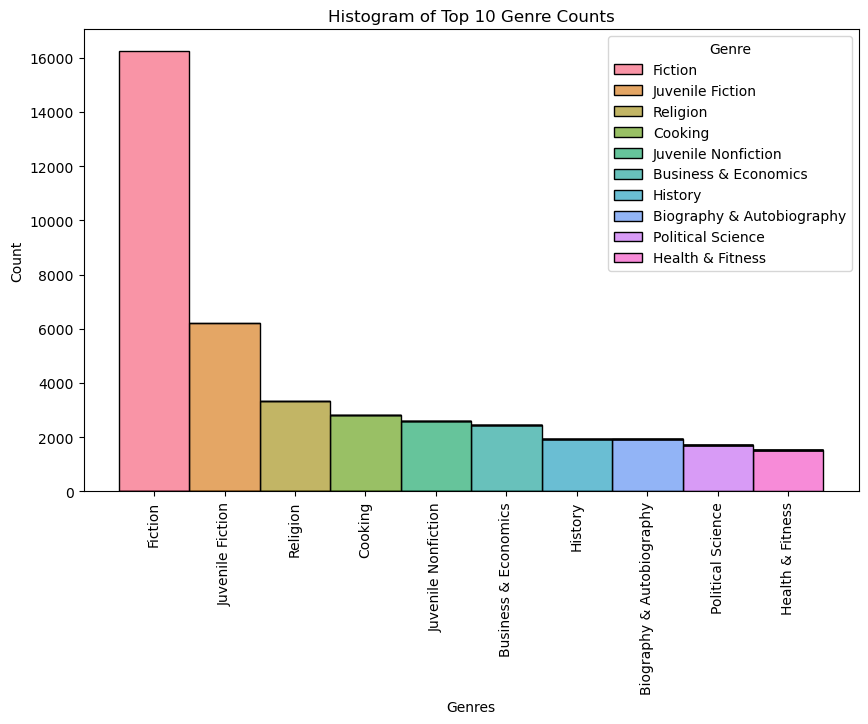

In [25]:
# Count the occurrences of each category
category_counts = df_cleaned['Category'].value_counts().reset_index()
category_counts.columns = ['Genre', 'Count']

# Select the top N categories (e.g., top 10)
top_n = 10
top_categories = category_counts.nlargest(top_n, 'Count')

# Set the size of the plot
plt.figure(figsize=(10, 6))

# Create a histogram using seaborn for the top N genres with different colors
sns.histplot(data=top_categories, x='Genre', weights='Count', hue='Genre', multiple='stack', palette='husl', bins=top_n)

# Customize the plot
plt.title(f'Histogram of Top {top_n} Genre Counts')
plt.xlabel('Genres')
plt.ylabel('Count')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability

# Show the plot
plt.show()

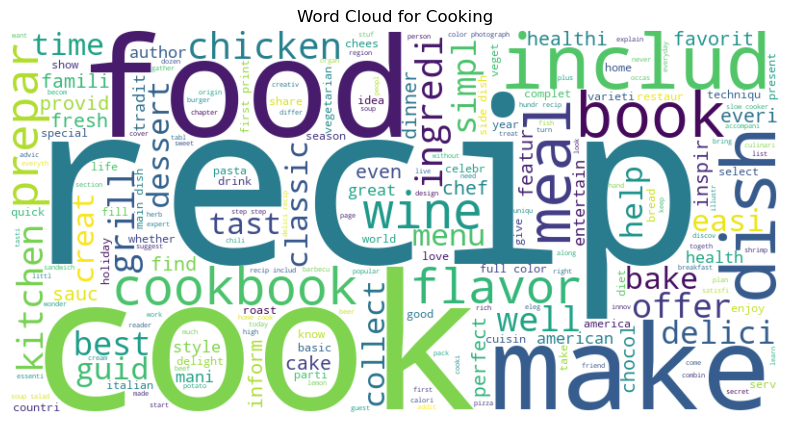

In [26]:
# Example: Assuming df_cleaned is your DataFrame and you want to create a word cloud for a specific category
category_name = 'Cooking'  # Change this to the category you are interested in

# Filter the DataFrame to get descriptions for the chosen category
category_descriptions = df_cleaned[df_cleaned['Category'] == category_name]['Description']

# Combine all descriptions into a single string
text = ' '.join(category_descriptions)

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

# Set up the plot
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Hide axes

# Show the plot
plt.title(f'Word Cloud for {category_name}')
plt.show()

### Word Cloud

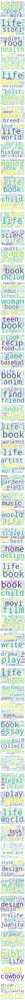

In [27]:
from math import ceil

# Get unique categories
categories = df_cleaned['Category'].unique()

# Set up the plot for a single-column layout
plt.figure(figsize=(10, len(categories) * 5))  # Adjust the size based on the number of categories

# Loop through each category to generate and plot the word cloud
for i, category in enumerate(categories):
    plt.subplot(len(categories), 1, i + 1)  # Create a single column grid
    
    # Filter the DataFrame for the current category
    category_descriptions = df_cleaned[df_cleaned['Category'] == category]['Description']
    
    # Combine all descriptions into a single string
    text = ' '.join(category_descriptions)
    
    # Generate the word cloud
    wordcloud = WordCloud(width=300, height=200, background_color='white').generate(text)
    
    # Plot the word cloud
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(category)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

In [28]:
#Converting all the categorical features of 'category' to numerical
df_cleaned['Encoded'] = LabelEncoder().fit_transform(df_cleaned['Category'])
df_cleaned.head()

,Title,Description,Category,Encoded
7,journey heartsong,collect poem written eleven year muscular dyst...,Poetry,40
8,search melancholi babi,russian author offer affection chronicl life u...,Biography & Autobiography,4
10,dieter guid weight loss,humor classic tongu cheek diet plan base calor...,Health & Fitness,21
11,germ biolog weapon america secret,dead germ spray shop mall bomb spew anthrax sp...,Technology & Engineering,50
13,good book read bibl mind heart,bibl social moral consequ deriv interpret impo...,Religion,44


In [29]:
X = CountVectorizer().fit_transform(df_cleaned['Description'])
y = df_cleaned['Encoded']

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

In [31]:
# models = [MultinomialNB(),SGDClassifier(),LogisticRegression(),RandomForestClassifier(),GradientBoostingClassifier(),
#          AdaBoostClassifier(),SVC(),DummyClassifier(),ExtraTreeClassifier(),KNeighborsClassifier()]


models=[
    MultinomialNB(),  # No specific changes needed here
#     SGDClassifier(max_iter=1000, tol=1e-4),
    LogisticRegression(max_iter=1000, tol=1e-4),
#     RandomForestClassifier(n_estimators=200),
#     SVC(max_iter=1000),  # Increase max_iter if necessary
    DummyClassifier(),
    KNeighborsClassifier() 
]

    # No specific changes needed here
     


### One vs Rest Classifer

In [32]:
Name = []
Accuracy = []
Precision = []
F1_Score = []
Recall = []
Time_Taken = []
for model in models:
    name = type(model).__name__
    Name.append(name)
    model = OneVsRestClassifier(model)
    begin = time.time()
    model.fit(X_train,y_train)
    prediction = model.predict(X_test)
    end = time.time()
    Accuracy.append(accuracy_score(prediction,y_test))
    Precision.append(precision_score(prediction,y_test,average = 'macro'))
    Recall.append(recall_score(prediction,y_test,average = 'macro'))
    F1_Score.append(f1_score(prediction,y_test,average = 'macro'))
    Time_Taken.append(end-begin)
    print(name + ' Successfully Trained')

C:\Users\NTech\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MultinomialNB Successfully Trained
LogisticRegression Successfully Trained


C:\Users\NTech\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DummyClassifier Successfully Trained
KNeighborsClassifier Successfully Trained


C:\Users\NTech\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [33]:
Dict = {'Name':Name,'Accuracy':Accuracy,'Precision_score':Precision,'Recall_score':Recall,
        'F1_score':F1_Score,'Time Taken':Time_Taken}
model_df = pd.DataFrame(Dict)
model_df

,Name,Accuracy,Precision_score,Recall_score,F1_score,Time Taken
0,MultinomialNB,0.605492,0.243629,0.467321,0.255203,1.846580
1,LogisticRegression,0.667096,0.435231,0.549528,0.466738,162.973676
2,DummyClassifier,0.263811,0.018182,0.004797,0.007591,0.160483
3,KNeighborsClassifier,0.267756,0.196218,0.358715,0.226472,1882.776829


### Modeling without using One vs Rest Classifer

In [34]:
Name = []
Accuracy = []
Precision = []
F1_Score = []
Recall = []
Time_Taken = []
for model in models:
    name = type(model).__name__
    Name.append(name)
    begin = time.time()
    model.fit(X_train,y_train)
    prediction = model.predict(X_test)
    end = time.time()
    Accuracy.append(accuracy_score(prediction,y_test))
    Precision.append(precision_score(prediction,y_test,average = 'macro'))
    Recall.append(recall_score(prediction,y_test,average = 'macro'))
    F1_Score.append(f1_score(prediction,y_test,average = 'macro'))
    Time_Taken.append(end-begin)
    print(name + ' Successfully Trained')

C:\Users\NTech\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MultinomialNB Successfully Trained
LogisticRegression Successfully Trained
DummyClassifier Successfully Trained


C:\Users\NTech\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


KNeighborsClassifier Successfully Trained


C:\Users\NTech\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [35]:
Dict = {'Name':Name,'Accuracy':Accuracy,'Precision_score':Precision,'Recall_score':Precision,
        'F1_score':F1_Score,'Time Taken':Time_Taken}
model_df = pd.DataFrame(Dict)
model_df

,Name,Accuracy,Precision_score,Recall_score,F1_score,Time Taken
0,MultinomialNB,0.604928,0.237865,0.237865,0.248406,0.795153
1,LogisticRegression,0.659043,0.442695,0.442695,0.468302,324.677248
2,DummyClassifier,0.263811,0.018182,0.018182,0.007591,0.008977
3,KNeighborsClassifier,0.293928,0.197056,0.197056,0.218687,30.058821


In [37]:
import plotly.express as px

In [39]:
model_df.sort_values(by = 'Accuracy',ascending = False,inplace = True)
fig = px.line(model_df, x="Name", y="Accuracy", title='Accuracy VS Model')
fig.show()

In [40]:
model_df.sort_values(by = 'Time Taken',ascending = False,inplace = True)
fig = px.line(model_df, x="Name", y="Time Taken", title='Time Taken VS Model')
fig.show()

### Conclusion

The Multinomial NB takes less time.The Logistic Regression has the highest Accuracy. 